# Drive Mounted

In [66]:
# Code to mount Google Drive in Google Colab
# This allows access to files stored in your Google Drive
from google.colab import drive  # Import the library to handle Google Drive in Colab
drive.mount('/content/drive')  # Mount the Google Drive to the Colab environment

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Importing Libraries

In [67]:
# Code to uninstall the pandas-profiling package
# This ensures that the current version of pandas-profiling is removed if it's installed
!pip uninstall -y pandas-profiling  # '-y' flag automatically confirms the uninstallation

In [68]:
# # Code to install the ydata-profiling package
# This package is used for generating detailed data profiling reports
!pip install ydata-profiling  # Installs the ydata-profiling library

In [69]:
# Import necessary libraries for data manipulation, visualization, and modeling
import numpy as np  # For numerical computations
import pandas as pd  # For data manipulation and analysis
import matplotlib.pyplot as plt  # For plotting graphs
import seaborn as sns  # For statistical data visualization
from sklearn import preprocessing  # For data preprocessing functions
from ydata_profiling import ProfileReport  # For generating automated data profiling reports
import matplotlib.ticker as mtick  # For formatting ticks on plots

# Importing evaluation and model selection functions from sklearn
from sklearn.metrics import accuracy_score, roc_auc_score, roc_curve, auc  # For model evaluation metrics
from sklearn.model_selection import train_test_split  # For splitting data into training and testing sets
from sklearn.preprocessing import StandardScaler, LabelEncoder  # For data standardization and encoding
from sklearn.model_selection import GridSearchCV  # For hyperparameter tuning using grid search

In [70]:
# Code to install the pydantic-settings package
# This package is used for managing application settings and environment variables
!pip install pydantic-settings  # Installs the pydantic-settings library

# Connecting Excel Sheet to Colab

In [71]:
# Code to load the dataset from an Excel file stored in Google Drive
# The dataset contains information related to Coronary Heart Disease
df = pd.read_excel('/content/drive/MyDrive/Machine Learning Projects/Machine Learning Classification Project/Coronary Heart Disease dataset.xlsx')

# Display the first 5 rows of the dataset to check if it's loaded correctly
df.head()

,Age,Weight,Length,Sex,BMI,DM,HTN,Current Smoker,EX-Smoker,FH,...,K,Na,WBC,Lymph,Neut,PLT,EF-TTE,Region RWMA,VHD,Cath
0,53,90,175,Male,29.387755,0,1,1,0,0,...,4.7,141,5700,39,52,261,50,0,N,Cad
1,67,70,157,Fmale,28.398718,0,1,0,0,0,...,4.7,156,7700,38,55,165,40,4,N,Cad
2,54,54,164,Male,20.077335,0,0,1,0,0,...,4.7,139,7400,38,60,230,40,2,mild,Cad
3,66,67,158,Fmale,26.838648,0,1,0,0,0,...,4.4,142,13000,18,72,742,55,0,Severe,Normal
4,50,87,153,Fmale,37.165193,0,1,0,0,0,...,4.0,140,9200,55,39,274,50,0,Severe,Normal


# Exploratory Data Analysis

In [72]:
# Code to display the column names of the dataset
# This helps in understanding the structure and features of the dataset
df.columns

Index(['Age', 'Weight', 'Length', 'Sex', 'BMI', 'DM', 'HTN', 'Current Smoker',
       'EX-Smoker', 'FH', 'Obesity', 'CRF', 'CVA', 'Airway disease',
       'Thyroid Disease', 'CHF', 'DLP', 'BP', 'PR', 'Edema',
       'Weak Peripheral Pulse', 'Lung rales', 'Systolic Murmur',
       'Diastolic Murmur', 'Typical Chest Pain', 'Dyspnea', 'Function Class',
       'Atypical', 'Nonanginal', 'Exertional CP', 'LowTH Ang', 'Q Wave',
       'St Elevation', 'St Depression', 'Tinversion', 'LVH',
       'Poor R Progression', 'BBB', 'FBS', 'CR', 'TG', 'LDL', 'HDL', 'BUN',
       'ESR', 'HB', 'K', 'Na', 'WBC', 'Lymph', 'Neut', 'PLT', 'EF-TTE',
       'Region RWMA', 'VHD', 'Cath'],
      dtype='object')

In [73]:
# Code to display a concise summary of the dataset
# This provides information about the data types, non-null values, and memory usage of each column
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 303 entries, 0 to 302
Data columns (total 56 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   Age                    303 non-null    int64  
 1   Weight                 303 non-null    int64  
 2   Length                 303 non-null    int64  
 3   Sex                    303 non-null    object 
 4   BMI                    303 non-null    float64
 5   DM                     303 non-null    int64  
 6   HTN                    303 non-null    int64  
 7   Current Smoker         303 non-null    int64  
 8   EX-Smoker              303 non-null    int64  
 9   FH                     303 non-null    int64  
 10  Obesity                303 non-null    object 
 11  CRF                    303 non-null    object 
 12  CVA                    303 non-null    object 
 13  Airway disease         303 non-null    object 
 14  Thyroid Disease        303 non-null    object 
 15  CHF   

In [74]:
# Code to generate descriptive statistics of the dataset
# This provides summary statistics for numerical columns, including count, mean, std, min, max, and percentiles
df.describe()

,Age,Weight,Length,BMI,DM,HTN,Current Smoker,EX-Smoker,FH,BP,...,ESR,HB,K,Na,WBC,Lymph,Neut,PLT,EF-TTE,Region RWMA
count,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,...,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000,303.000000
mean,58.897690,73.831683,164.716172,27.248339,0.297030,0.590759,0.207921,0.033003,0.158416,129.554455,...,19.462046,13.153465,4.230693,140.996700,7562.046205,32.399340,60.148515,221.488449,47.231023,0.620462
std,10.392278,11.987358,9.327661,4.098865,0.457706,0.492507,0.406491,0.178941,0.365734,18.938105,...,15.936475,1.610452,0.458202,3.807885,2413.739323,9.972592,10.182493,60.796199,8.927194,1.132531
min,30.000000,48.000000,140.000000,18.115413,0.000000,0.000000,0.000000,0.000000,0.000000,90.000000,...,1.000000,8.900000,3.000000,128.000000,3700.000000,7.000000,32.000000,25.000000,15.000000,0.000000
25%,51.000000,65.000000,158.000000,24.514380,0.000000,0.000000,0.000000,0.000000,0.000000,120.000000,...,9.000000,12.200000,3.900000,139.000000,5800.000000,26.000000,52.500000,183.500000,45.000000,0.000000
50%,58.000000,74.000000,165.000000,26.775510,0.000000,1.000000,0.000000,0.000000,0.000000,130.000000,...,15.000000,13.200000,4.200000,141.000000,7100.000000,32.000000,60.000000,210.000000,50.000000,0.000000
75%,66.000000,81.000000,171.000000,29.411765,1.000000,1.000000,0.000000,0.000000,0.000000,140.000000,...,26.000000,14.200000,4.500000,143.000000,8800.000000,39.000000,67.000000,250.000000,55.000000,1.000000
max,86.000000,120.000000,188.000000,40.900658,1.000000,1.000000,1.000000,1.000000,1.000000,190.000000,...,90.000000,17.600000,6.600000,156.000000,18000.000000,60.000000,89.000000,742.000000,60.000000,4.000000


In [75]:
# Code to create a profiling report for the Coronary Artery Disease dataset
# The report provides an overview of the dataset's structure, distributions, and relationships
profile = ProfileReport(df, title="Profiling Report for CAD", html={'style':{'full_width':True}}, sort='Ascending')

# Save the profiling report to an HTML file for easy viewing
profile.to_file(output_file='CAD_profile.html')

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

In [76]:
# Code to display the profiling report in the notebook
# This will render the report directly in the output cell for easy visualization
profile

In [77]:
# Code to check for missing values in the dataset
# This will return the count of null (missing) values for each column
df.isnull().sum()

,0
Age,0
Weight,0
Length,0
Sex,0
BMI,0
DM,0
HTN,0
Current Smoker,0
EX-Smoker,0
FH,0


In [78]:
# Code to calculate and print the median age of CAD patients and other patients
# This distinguishes between patients diagnosed with CAD and those labeled as normal
print(f"Median age of CAD patients is {df[df['Cath']=='Cad']['Age'].median()} years")  # Median age for CAD patients
print(f"Median age of other patients is {df[df['Cath']=='Normal']['Age'].median()} years")  # Median age for normal patients

Median age of CAD patients is 61.5 years
Median age of other patients is 52.0 years


In [79]:
# Code to calculate and print the average weight of CAD patients and normal patients
# This distinguishes between patients diagnosed with CAD and those labeled as normal
print(f"Average weight of CAD patients is {round(df[df['Cath']=='Cad']['Weight'].mean(), 2)} kg")  # Average weight for CAD patients
print(f"Average weight of Normal patients is {round(df[df['Cath']=='Normal']['Weight'].mean(), 2)} kg")  # Average weight for normal patients

Average weight of CAD patients is 73.32 kg
Average weight of Normal patients is 75.09 kg


In [80]:
# Code to calculate and print the average systolic blood pressure of CAD patients and normal patients
# This distinguishes between patients diagnosed with CAD and those labeled as normal
print(f"Average systolic BP of CAD patients is {round(df[df['Cath']=='Cad']['BP'].mean(), 2)} mmHg")  # Average BP for CAD patients
print(f"Average systolic BP of Normal patients is {round(df[df['Cath']=='Normal']['BP'].mean(), 2)} mmHg")  # Average BP for normal patients

Average systolic BP of CAD patients is 132.41 mmHg
Average systolic BP of Normal patients is 122.47 mmHg


In [81]:
# Code to categorize LDL cholesterol levels into defined bins
# Bins represent cholesterol ranges: optimal, borderline, high, and very high
bins = [0, 129, 159, 189, 300]  # Define the edges of the bins
labels = ['optimal', 'borderline', 'high', 'very high']  # Define the corresponding labels for each bin
df['cholesterol_level'] = pd.cut(df.LDL, bins=bins, labels=labels)  # Categorize LDL values into cholesterol levels

# Calculate and round the percentage distribution of each cholesterol level category
round(df['cholesterol_level'].value_counts(1) * 100)  # Display percentage distribution of cholesterol levels

,proportion
cholesterol_level,
optimal,79.0
borderline,14.0
high,6.0
very high,2.0


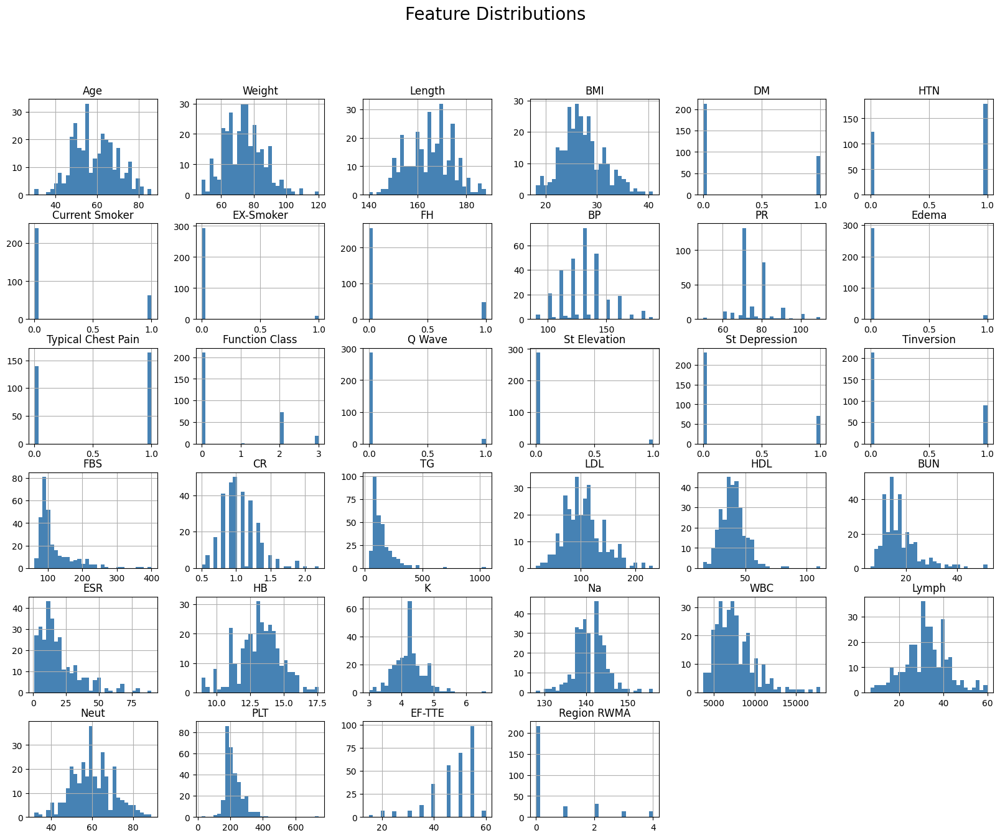

In [82]:
# Code to plot histograms for all numerical features in the DataFrame
# The histograms will display the distribution of each feature, helping to visualize their spread and central tendencies
df.hist(bins=30, figsize=(20, 15), color='steelblue')  # Create histograms with 30 bins for each feature, set figure size and color

# Add a main title to the plot
plt.suptitle("Feature Distributions", fontsize=20)  # Set the title for the entire figure
plt.show()  # Display the histograms

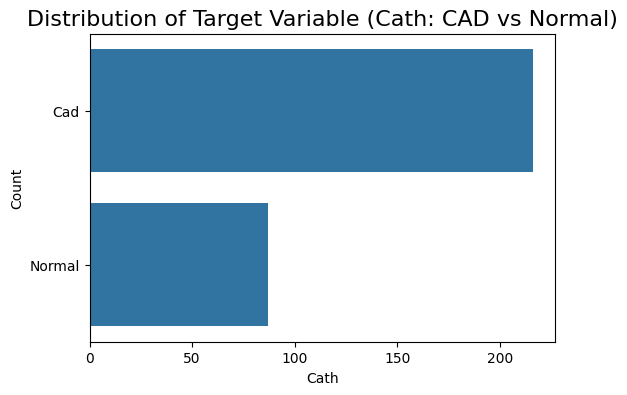

In [83]:
# Code to plot the distribution of the target variable 'Cath'
# This visualization helps to understand the balance between CAD patients and normal patients
plt.figure(figsize=(6, 4))  # Set the figure size for the plot
sns.countplot(df['Cath'])  # Create a count plot for the 'Cath' column, showing the counts of each category

# Set the title and labels for the plot
plt.title('Distribution of Target Variable (Cath: CAD vs Normal)', fontsize=16)  # Title for the plot
plt.xlabel('Cath')  # Label for the x-axis
plt.ylabel('Count')  # Label for the y-axis
plt.show()  # Display the count plot

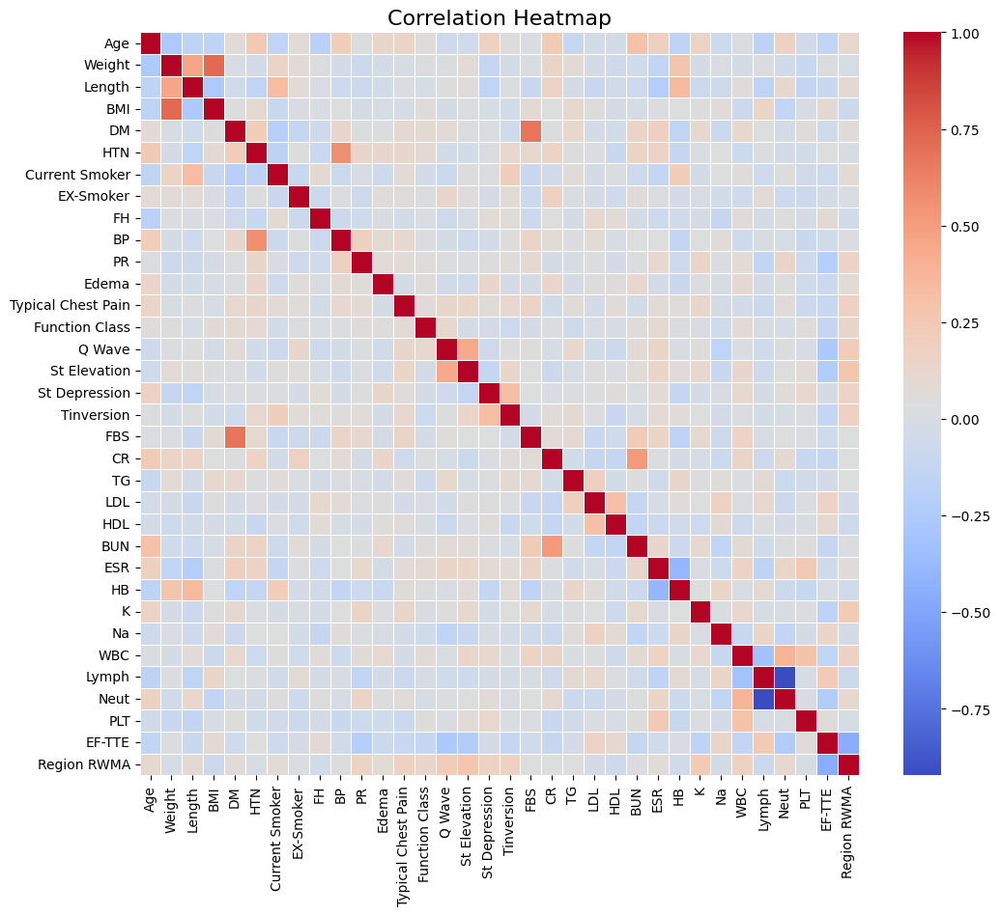

In [84]:
# Code to create a correlation heatmap for numerical features in the DataFrame
# This visualization helps to identify relationships between different numerical variables
numerical_df = df.select_dtypes(include=['int64', 'float64'])  # Select only the numerical columns (int and float types)
corr_matrix = numerical_df.corr()  # Calculate the correlation matrix for the numerical features

# Set up the figure for the heatmap
plt.figure(figsize=(12, 10))  # Define the size of the heatmap

# Create a heatmap using seaborn to visualize the correlation matrix
sns.heatmap(corr_matrix, annot=False, cmap='coolwarm', linewidths=0.5)  # Draw the heatmap without annotations, using a color palette

# Set the title for the heatmap
plt.title('Correlation Heatmap', fontsize=16)  # Title of the heatmap
plt.show()  # Display the heatmap

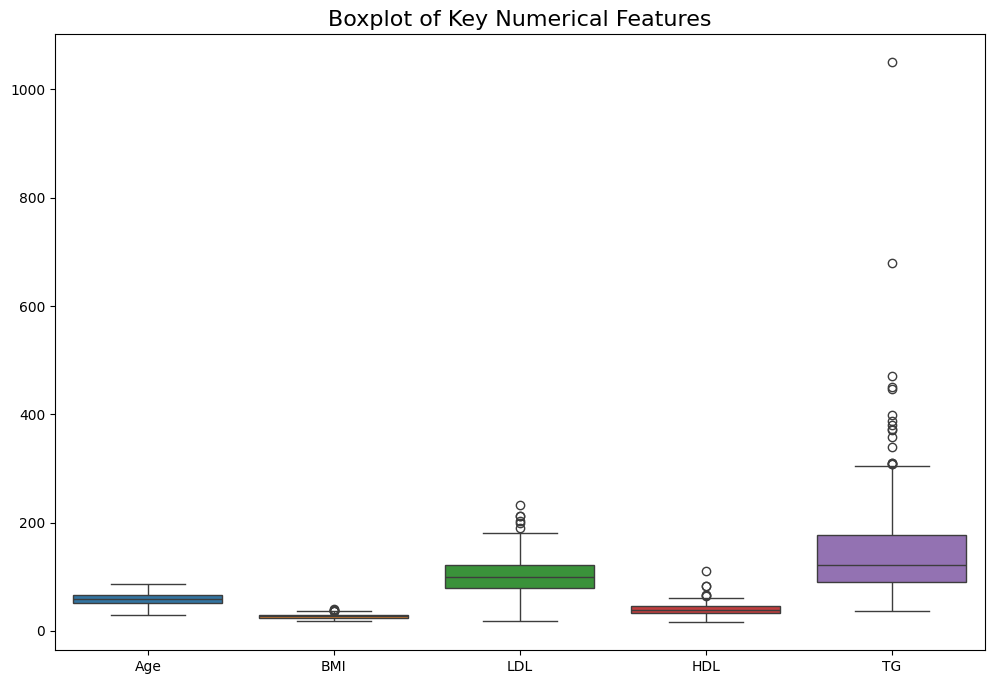

In [85]:
# Code to create boxplots for selected key numerical features in the DataFrame
# This visualization helps to identify the distribution and outliers in the data
plt.figure(figsize=(12, 8))  # Set the size of the figure for the boxplot

# Create a boxplot for the specified numerical features
sns.boxplot(data=df[['Age', 'BMI', 'LDL', 'HDL', 'TG']])  # Boxplot for Age, BMI, LDL, HDL, and Triglycerides

# Set the title for the boxplot
plt.title('Boxplot of Key Numerical Features', fontsize=16)  # Title for the boxplot
plt.show()  # Display the boxplot

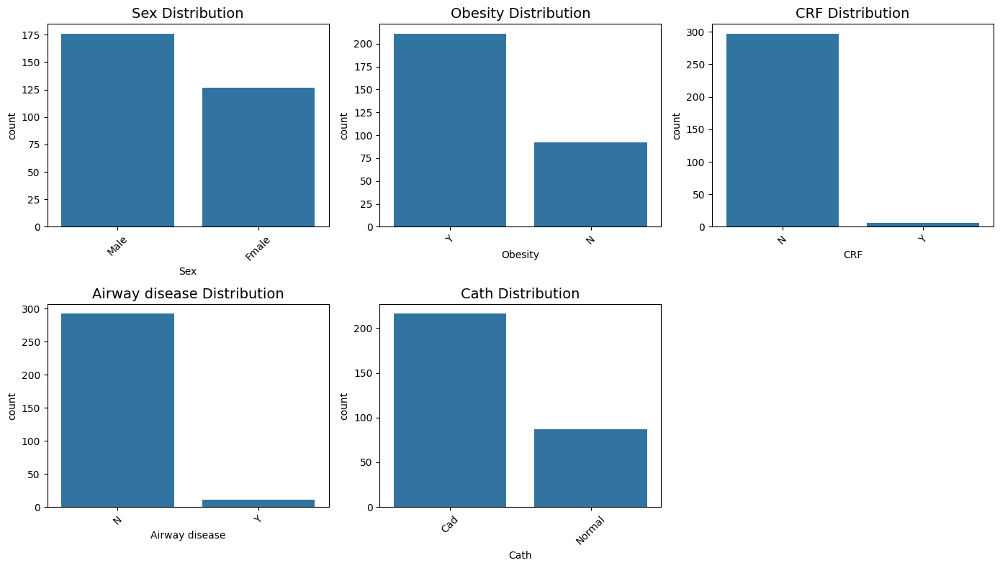

In [86]:
# Define a list of categorical features to visualize
categorical_features = ['Sex', 'Obesity', 'CRF', 'Airway disease', 'Cath']

# Set the figure size for the subplots
plt.figure(figsize=(14, 8))

# Loop through each categorical feature to create a count plot
for i, feature in enumerate(categorical_features):
    plt.subplot(2, 3, i+1)  # Create a subplot for each feature
    sns.countplot(x=feature, data=df)  # Create a count plot for the current feature
    plt.title(f'{feature} Distribution', fontsize=14)  # Set the title for the subplot
    plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Adjust the layout to prevent overlap of subplots
plt.tight_layout()
plt.show()  # Display all the count plots

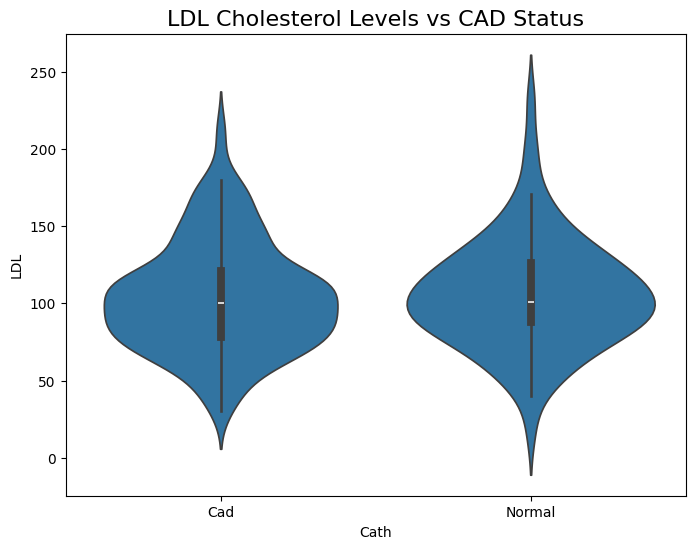

In [87]:
# Set the figure size for the violin plot
plt.figure(figsize=(8, 6))

# Create a violin plot to visualize the distribution of LDL cholesterol levels by CAD status
sns.violinplot(x='Cath', y='LDL', data=df)

# Set the title for the plot
plt.title('LDL Cholesterol Levels vs CAD Status', fontsize=16)

# Display the plot
plt.show()

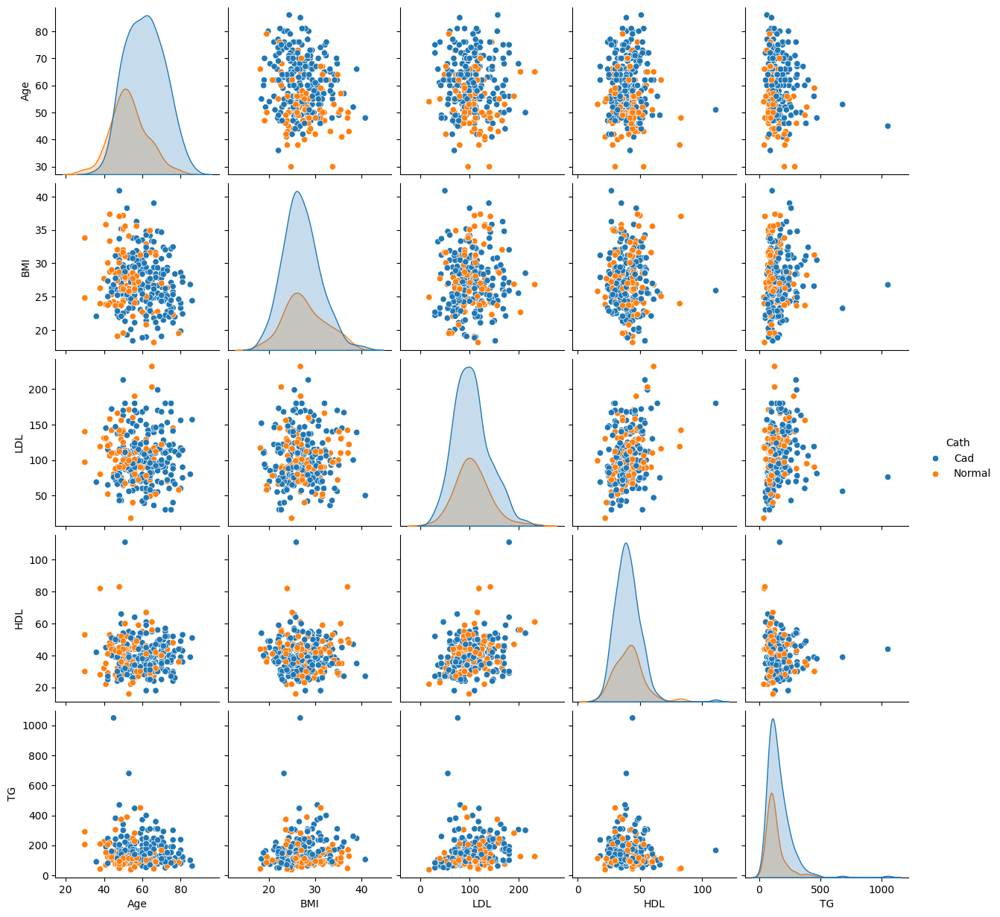

In [88]:
# Create a pair plot to visualize relationships between selected features
# The 'hue' parameter distinguishes between the two classes in the target variable (Cath: CAD vs Normal)
sns.pairplot(df[['Age', 'BMI', 'LDL', 'HDL', 'TG', 'Cath']], hue='Cath')

# Display the pair plot
plt.show()

In [89]:
# Calculate the normalized counts (percentages) of the target variable 'Cath'
cad_count = df['Cath'].value_counts(normalize=True)

# Print the percentage of CAD patients
print(f"CAD Patients: {cad_count['Cad'] * 100:.2f}%")

# Print the percentage of Normal patients
print(f"Normal Patients: {cad_count['Normal'] * 100:.2f}%")

CAD Patients: 71.29%
Normal Patients: 28.71%


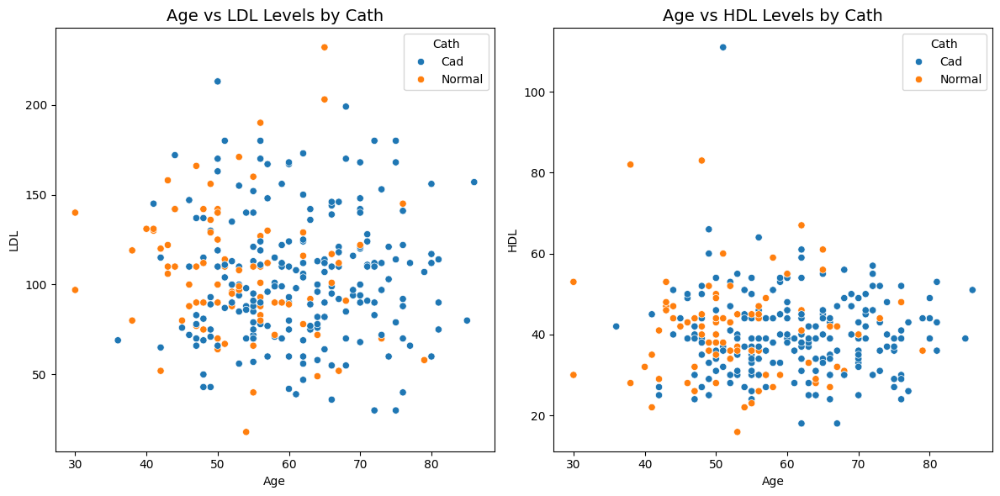

In [90]:
# Set the figure size for the scatter plots
plt.figure(figsize=(12, 6))

# Create the first subplot for Age vs LDL levels
plt.subplot(1, 2, 1)  # 1 row, 2 columns, first subplot
sns.scatterplot(x='Age', y='LDL', hue='Cath', data=df)  # Scatter plot with hue based on CAD status
plt.title('Age vs LDL Levels by Cath', fontsize=14)  # Title for the first subplot

# Create the second subplot for Age vs HDL levels
plt.subplot(1, 2, 2)  # 1 row, 2 columns, second subplot
sns.scatterplot(x='Age', y='HDL', hue='Cath', data=df)  # Scatter plot with hue based on CAD status
plt.title('Age vs HDL Levels by Cath', fontsize=14)  # Title for the second subplot

# Adjust layout to prevent overlapping of subplots
plt.tight_layout()

# Display the scatter plots
plt.show()

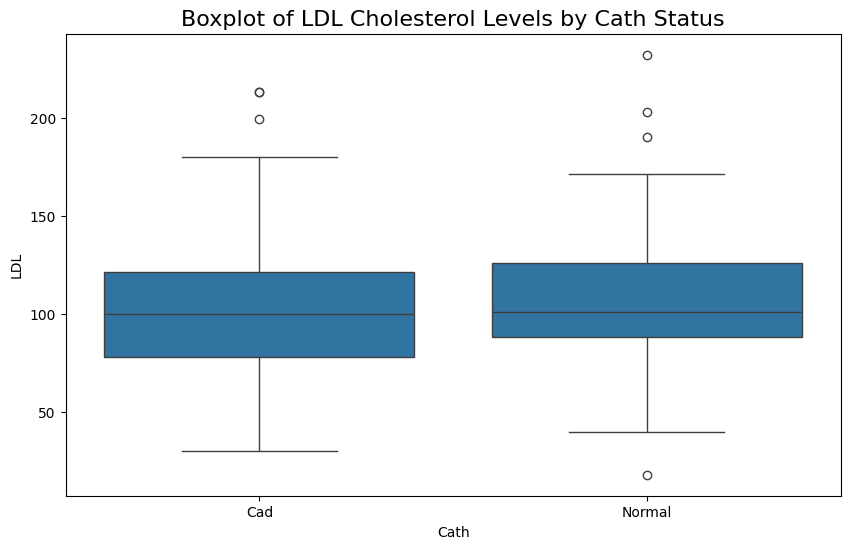

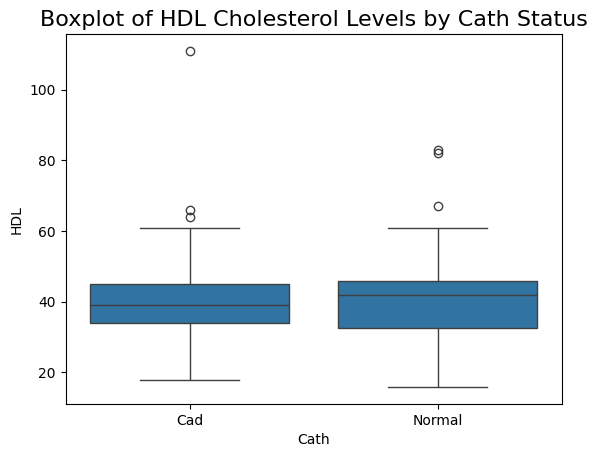

In [91]:
# Set the figure size for the boxplot of LDL cholesterol levels
plt.figure(figsize=(10, 6))

# Create a boxplot for LDL cholesterol levels categorized by CAD status
sns.boxplot(x='Cath', y='LDL', data=df)  # x-axis: Cath status, y-axis: LDL levels
plt.title('Boxplot of LDL Cholesterol Levels by Cath Status', fontsize=16)  # Title for the LDL boxplot
plt.show()  # Display the LDL boxplot

# Create a boxplot for HDL cholesterol levels categorized by CAD status
sns.boxplot(x='Cath', y='HDL', data=df)  # x-axis: Cath status, y-axis: HDL levels
plt.title('Boxplot of HDL Cholesterol Levels by Cath Status', fontsize=16)  # Title for the HDL boxplot
plt.show()  # Display the HDL boxplot

In [92]:
# Import Logistic Regression model from sklearn's linear_model module
from sklearn.linear_model import LogisticRegression

# Import Random Forest Classifier from sklearn's ensemble module
from sklearn.ensemble import RandomForestClassifier

# Import K-Nearest Neighbors Classifier from sklearn's neighbors module
from sklearn.neighbors import KNeighborsClassifier

# Import XGBoost Classifier from the xgboost library
from xgboost import XGBClassifier

In [93]:
# Convert 'Cath' column to binary values: 1 for 'Cad' (CAD patients) and 0 for 'Normal' (non-CAD patients)
df['Cath'] = df['Cath'].apply(lambda x: 1 if x == 'Cad' else 0)

In [94]:
# Perform one-hot encoding on categorical variables in the DataFrame,
# dropping the first category to avoid the dummy variable trap
df_encoded = pd.get_dummies(df, drop_first=True)

In [95]:
# Perform one-hot encoding on all categorical variables in the DataFrame,
# excluding the target variable 'Cath' and dropping the first category to avoid the dummy variable trap
df_encoded = pd.get_dummies(df, columns=df.columns.difference(['Cath']), drop_first=True)

In [96]:
# Separate the features (X) and target variable (y) for model training,
# dropping the target variable 'Cath' from the DataFrame to create the features set
X = df_encoded.drop('Cath', axis=1)
y = df_encoded['Cath']

In [97]:
# Split the dataset into training and testing sets,
# using 20% of the data for testing and setting a random seed for reproducibility
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [98]:
# Initialize the StandardScaler to standardize the features by removing the mean and scaling to unit variance
# Fit the scaler on the training data and transform both the training and testing datasets
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [99]:
# Initialize the KNeighborsClassifier with 5 neighbors and fit it on the scaled training data
knn = KNeighborsClassifier(n_neighbors=5)
knn.fit(X_train_scaled, y_train)

KNeighborsClassifier()

In [100]:
# Predict the labels for the test set and obtain the predicted probabilities for the positive class (1) using the KNN model
y_pred_knn = knn.predict(X_test_scaled)  # Predict the class labels for the test set
y_pred_prob_knn = knn.predict_proba(X_test_scaled)[:, 1]  # Get the predicted probabilities for the positive class (CAD)

In [101]:
# Calculate the accuracy of the KNN model by comparing the predicted labels to the true labels in the test set
accuracy_knn = accuracy_score(y_test, y_pred_knn)  # Compute the accuracy score
print(f"KNN Accuracy: {accuracy_knn * 100:.2f}%")  # Print the accuracy as a percentage

KNN Accuracy: 34.43%


In [102]:
# Calculate the AUC-ROC score for the KNN model using the predicted probabilities
auc_knn = roc_auc_score(y_test, y_pred_prob_knn)  # Compute the AUC-ROC score
print(f"KNN AUC-ROC: {auc_knn:.2f}")  # Print the AUC-ROC score rounded to two decimal places

KNN AUC-ROC: 0.54


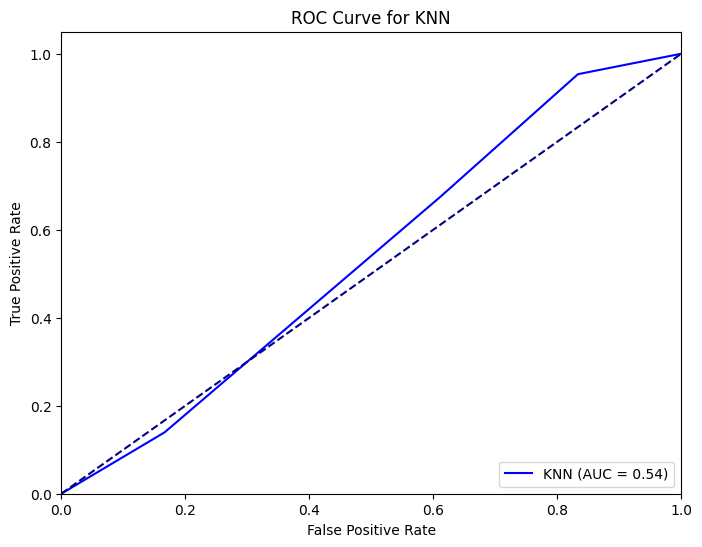

In [103]:
# Compute the false positive rate (fpr) and true positive rate (tpr) for the KNN model
fpr_knn, tpr_knn, _ = roc_curve(y_test, y_pred_prob_knn)

# Set up the figure for the ROC curve
plt.figure(figsize=(8, 6))
# Plot the ROC curve for KNN, including the AUC value in the label
plt.plot(fpr_knn, tpr_knn, color='blue', label=f'KNN (AUC = {auc_knn:.2f})')
# Add a dashed line representing the chance level
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')
plt.xlim([0.0, 1.0])  # Set x-axis limits
plt.ylim([0.0, 1.05])  # Set y-axis limits
plt.xlabel('False Positive Rate')  # Label for the x-axis
plt.ylabel('True Positive Rate')  # Label for the y-axis
plt.title('ROC Curve for KNN')  # Title of the plot
plt.legend(loc="lower right")  # Position the legend
plt.show()  # Display the plot

In [104]:
# Initialize a Logistic Regression model
logreg = LogisticRegression()

# Fit the Logistic Regression model to the training data
logreg.fit(X_train, y_train)

LogisticRegression()

In [105]:
# Predict the target values (CAD status) for the test set using the trained Logistic Regression model
y_pred_logreg = logreg.predict(X_test)

# Predict the probabilities for the positive class (CAD) for the test set
y_pred_prob_logreg = logreg.predict_proba(X_test)[:, 1]

In [106]:
# Calculate the accuracy of the Logistic Regression model by comparing the predicted and actual target values
accuracy_logreg = accuracy_score(y_test, y_pred_logreg)

# Print the accuracy of the Logistic Regression model as a percentage
print(f"Logistic Regression Accuracy: {accuracy_logreg * 100:.2f}%")

Logistic Regression Accuracy: 83.61%


In [107]:
# Calculate the AUC-ROC score for the Logistic Regression model using the predicted probabilities
auc_logreg = roc_auc_score(y_test, y_pred_prob_logreg)

# Print the AUC-ROC score for the Logistic Regression model
print(f"Logistic Regression AUC-ROC: {auc_logreg:.2f}")

Logistic Regression AUC-ROC: 0.91


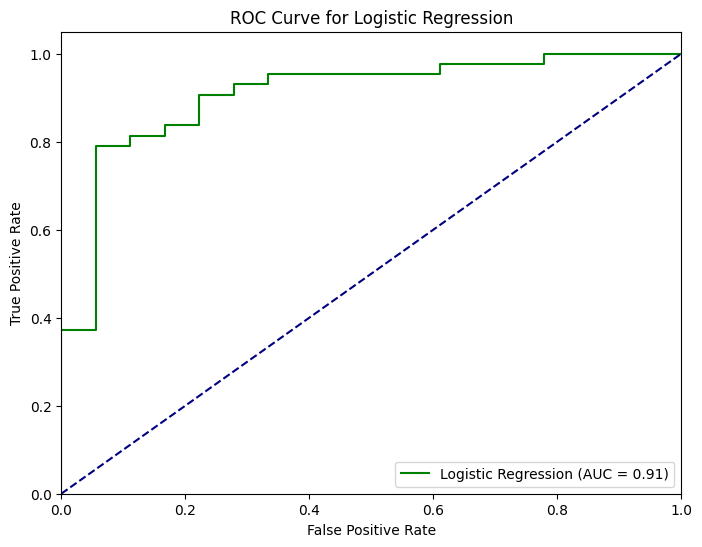

In [108]:
# Generate the false positive rate and true positive rate for the ROC curve of the Logistic Regression model
fpr_logreg, tpr_logreg, _ = roc_curve(y_test, y_pred_prob_logreg)

# Create a new figure for plotting the ROC curve
plt.figure(figsize=(8, 6))

# Plot the ROC curve for the Logistic Regression model with AUC value
plt.plot(fpr_logreg, tpr_logreg, color='green', label=f'Logistic Regression (AUC = {auc_logreg:.2f})')

# Plot a diagonal dashed line representing a random classifier
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')

# Set the limits for the x-axis and y-axis
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])

# Label the x-axis and y-axis
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

# Set the title for the ROC curve plot
plt.title('ROC Curve for Logistic Regression')

# Add a legend in the lower right corner of the plot
plt.legend(loc="lower right")

# Display the ROC curve plot
plt.show()

In [109]:
# Initialize the Random Forest classifier with 100 trees and a fixed random seed for reproducibility
rf = RandomForestClassifier(n_estimators=100, random_state=42)

# Train the Random Forest classifier using the training data
rf.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [110]:
# Generate predictions on the test data
y_pred_rf = rf.predict(X_test)

# Generate predicted probabilities for the positive class (class '1') for the test data
y_pred_prob_rf = rf.predict_proba(X_test)[:, 1]

In [111]:
# Calculate accuracy for Random Forest
accuracy_rf = accuracy_score(y_test, y_pred_rf)
print(f"Random Forest Accuracy: {accuracy_rf * 100:.2f}%")

Random Forest Accuracy: 75.41%


In [112]:
# Calculate AUC-ROC for Random Forest
auc_rf = roc_auc_score(y_test, y_pred_prob_rf)
print(f"Random Forest AUC-ROC: {auc_rf:.2f}")

Random Forest AUC-ROC: 0.87


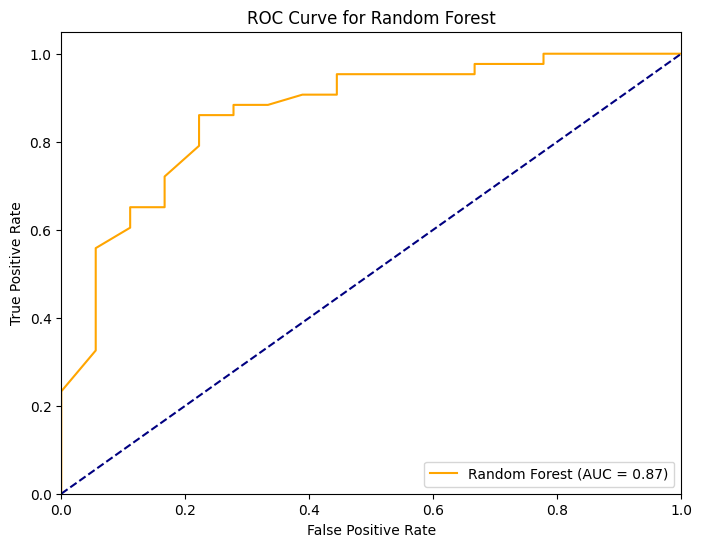

In [113]:
# Calculate the false positive rate (fpr), true positive rate (tpr), and thresholds for the ROC curve
fpr_rf, tpr_rf, _ = roc_curve(y_test, y_pred_prob_rf)

# Create a new figure for the ROC curve
plt.figure(figsize=(8, 6))

# Plot the ROC curve for the Random Forest model
plt.plot(fpr_rf, tpr_rf, color='orange', label=f'Random Forest (AUC = {auc_rf:.2f})')

# Plot a diagonal line for the random chance (no discrimination)
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')

# Set the limits for the x-axis and y-axis
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])

# Label the axes
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

# Set the title for the plot
plt.title('ROC Curve for Random Forest')

# Add a legend to the plot
plt.legend(loc="lower right")

# Display the plot
plt.show()

In [114]:
# Initialize the XGBoost classifier with specified parameters
xgb = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)

# Fit the XGBoost model to the training data
xgb.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [09:22:43] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)


XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=None,
              n_jobs=None, num_parallel_tree=None, random_state=42, ...)

In [115]:
# Predict the labels for the test set using the fitted XGBoost model
y_pred_xgb = xgb.predict(X_test)

# Predict the probabilities of the positive class (CAD) for the test set
y_pred_prob_xgb = xgb.predict_proba(X_test)[:, 1]

In [116]:
# Calculate the accuracy of the XGBoost model by comparing the predicted labels to the true labels
accuracy_xgb = accuracy_score(y_test, y_pred_xgb)

# Print the accuracy percentage of the XGBoost model
print(f"XGBoost Accuracy: {accuracy_xgb * 100:.2f}%")

XGBoost Accuracy: 80.33%


In [117]:
# Calculate the AUC-ROC score for the XGBoost model
# This score represents the model's ability to distinguish between the positive and negative classes
auc_xgb = roc_auc_score(y_test, y_pred_prob_xgb)

# Print the AUC-ROC score for the XGBoost model
print(f"XGBoost AUC-ROC: {auc_xgb:.2f}")

XGBoost AUC-ROC: 0.91


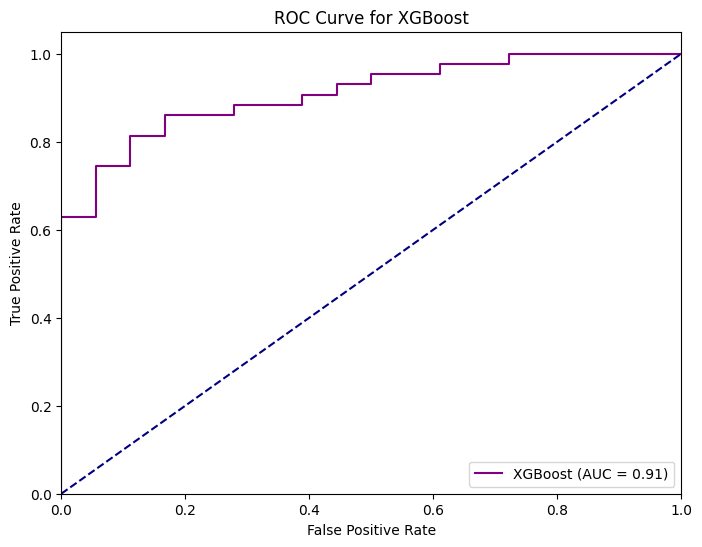

In [118]:
# Compute the False Positive Rate (FPR) and True Positive Rate (TPR) for the XGBoost model
# This will be used to plot the ROC curve
fpr_xgb, tpr_xgb, _ = roc_curve(y_test, y_pred_prob_xgb)

# Create a new figure for the ROC curve
plt.figure(figsize=(8, 6))

# Plot the ROC curve for XGBoost
plt.plot(fpr_xgb, tpr_xgb, color='purple', label=f'XGBoost (AUC = {auc_xgb:.2f})')

# Plot the diagonal line representing a random classifier
plt.plot([0, 1], [0, 1], color='navy', linestyle='--')

# Set the limits for the x-axis and y-axis
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])

# Label the axes
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')

# Set the title for the plot
plt.title('ROC Curve for XGBoost')

# Display the legend in the lower right corner
plt.legend(loc="lower right")

# Show the plot
plt.show()

Hyperparameter Tunning

In [119]:
# Define the parameter grid for K-Nearest Neighbors (KNN) hyperparameter tuning
param_grid_knn = {
    'n_neighbors': [3, 5, 7, 9, 11],  # List of different values for the number of neighbors to consider
    'weights': ['uniform', 'distance']  # List of options for weight function used in prediction
}

In [120]:
# Initialize the GridSearchCV object for hyperparameter tuning of the KNN model
grid_knn = GridSearchCV(KNeighborsClassifier(), param_grid_knn, cv=5, scoring='accuracy')

# Fit the GridSearchCV object to the training data to find the best hyperparameters
grid_knn.fit(X_train_scaled, y_train)

GridSearchCV(cv=5, estimator=KNeighborsClassifier(),
             param_grid={'n_neighbors': [3, 5, 7, 9, 11],
                         'weights': ['uniform', 'distance']},
             scoring='accuracy')

In [121]:
# Print the best hyperparameters found during the grid search for the KNN model
print("Best parameters for KNN:", grid_knn.best_params_)

# Print the best cross-validation score achieved with those parameters for the KNN model
print("Best cross-validation score for KNN:", grid_knn.best_score_)

Best parameters for KNN: {'n_neighbors': 11, 'weights': 'uniform'}
Best cross-validation score for KNN: 0.6274659863945578


In [122]:
# Define the parameter grid for hyperparameter tuning of the Logistic Regression model
param_grid_logreg = {
    'C': [0.01, 0.1, 1, 10, 100],  # Regularization strength
    'solver': ['liblinear', 'saga']  # Optimization algorithms to be used
}

In [123]:
# Create a GridSearchCV object for hyperparameter tuning of the Logistic Regression model
grid_logreg = GridSearchCV(
    LogisticRegression(),  # Logistic Regression model
    param_grid_logreg,    # Parameter grid defined earlier for tuning
    cv=5,                  # Number of cross-validation folds
    scoring='accuracy'     # Metric to evaluate model performance
)

# Fit the GridSearchCV object to the training data to find the best parameters
grid_logreg.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_sag.py:349: ConvergenceWarning: The max_iter was reached which 

GridSearchCV(cv=5, estimator=LogisticRegression(),
             param_grid={'C': [0.01, 0.1, 1, 10, 100],
                         'solver': ['liblinear', 'saga']},
             scoring='accuracy')

In [124]:
# Print the best hyperparameters found for the Logistic Regression model
print("Best parameters for Logistic Regression:", grid_logreg.best_params_)

# Print the best cross-validation score achieved with the best parameters
print("Best cross-validation score for Logistic Regression:", grid_logreg.best_score_)

Best parameters for Logistic Regression: {'C': 10, 'solver': 'liblinear'}
Best cross-validation score for Logistic Regression: 0.8513605442176871


In [125]:
# Define the parameter grid for tuning the Random Forest model
param_grid_rf = {
    'n_estimators': [50, 100, 200],  # Number of trees in the forest
    'max_depth': [None, 10, 20, 30],  # Maximum depth of the tree; None means nodes are expanded until all leaves are pure
    'min_samples_split': [2, 5, 10]   # Minimum number of samples required to split an internal node
}

In [126]:
# Create a GridSearchCV object for hyperparameter tuning of the Random Forest model
grid_rf = GridSearchCV(
    RandomForestClassifier(),  # The model to be optimized
    param_grid_rf,            # The parameter grid defined earlier
    cv=5,                      # Number of cross-validation folds
    scoring='accuracy'        # Metric used to evaluate the model's performance
)

# Fit the GridSearchCV object to the training data to find the best parameters
grid_rf.fit(X_train, y_train)

GridSearchCV(cv=5, estimator=RandomForestClassifier(),
             param_grid={'max_depth': [None, 10, 20, 30],
                         'min_samples_split': [2, 5, 10],
                         'n_estimators': [50, 100, 200]},
             scoring='accuracy')

In [127]:
# Print the best parameters found during the grid search for the Random Forest model
print("Best parameters for Random Forest:", grid_rf.best_params_)

# Print the best cross-validation score achieved with the best parameters for the Random Forest model
print("Best cross-validation score for Random Forest:", grid_rf.best_score_)

Best parameters for Random Forest: {'max_depth': None, 'min_samples_split': 2, 'n_estimators': 50}
Best cross-validation score for Random Forest: 0.8349489795918366


In [128]:
# Define the parameter grid for XGBoost model hyperparameter tuning
param_grid_xgb = {
    'n_estimators': [50, 100, 200],  # Number of trees in the ensemble
    'max_depth': [3, 5, 7],          # Maximum depth of the trees
    'learning_rate': [0.01, 0.1, 0.2] # Step size shrinkage to prevent overfitting
}

In [129]:
# Perform Grid Search for hyperparameter tuning on the XGBoost classifier
grid_xgb = GridSearchCV(
    XGBClassifier(use_label_encoder=False, eval_metric='logloss'),  # Initialize XGBoost classifier with specified options
    param_grid_xgb,  # Use the defined parameter grid for tuning
    cv=5,            # 5-fold cross-validation
    scoring='accuracy' # Use accuracy as the scoring metric
)

# Fit the model using the training data
grid_xgb.fit(X_train, y_train)

/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [09:23:48] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [09:23:50] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [09:23:52] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [09:23:56] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_encoder" } are not used.

  warnings.warn(smsg, UserWarning)
/usr/local/lib/python3.10/dist-packages/xgboost/core.py:158: UserWarning: [09:23:57] WARNING: /workspace/src/learner.cc:740: 
Parameters: { "use_label_e

GridSearchCV(cv=5,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, device=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False,
                                     eval_metric='logloss', feature_types=None,
                                     gamma=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=...
                                     max_cat_threshold=None,
                                     max_cat_to_onehot=None,
                                     max_delta_step=None, max_depth=None,
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     multi_strategy=None, n_estimators=None,
                                     n_jobs=None, num_parallel_tree=None,
                                     random_state=None, ...),
             param_grid={'learning_rate': [0.01, 0.1, 0.2],
                         'max_depth': [3, 5, 7],
                         'n_estimators': [50, 100, 200]},
             scoring='accuracy')

In [130]:
# Print the best parameters found by Grid Search for the XGBoost model
print("Best parameters for XGBoost:", grid_xgb.best_params_)

# Print the best cross-validation score obtained during the Grid Search for XGBoost
print("Best cross-validation score for XGBoost:", grid_xgb.best_score_)

Best parameters for XGBoost: {'learning_rate': 0.1, 'max_depth': 7, 'n_estimators': 200}
Best cross-validation score for XGBoost: 0.8595238095238095


In [131]:
from sklearn.metrics import precision_score, recall_score, f1_score

# For KNN
precision_knn = precision_score(y_test, y_pred_knn)
recall_knn = recall_score(y_test, y_pred_knn)
f1_knn = f1_score(y_test, y_pred_knn)

print(f"KNN - Precision: {precision_knn:.2f}, Recall: {recall_knn:.2f}, F1 Score: {f1_knn:.2f}")

# For Logistic Regression
precision_logreg = precision_score(y_test, y_pred_logreg)
recall_logreg = recall_score(y_test, y_pred_logreg)
f1_logreg = f1_score(y_test, y_pred_logreg)

print(f"Logistic Regression - Precision: {precision_logreg:.2f}, Recall: {recall_logreg:.2f}, F1 Score: {f1_logreg:.2f}")

# For Random Forest
precision_rf = precision_score(y_test, y_pred_rf)
recall_rf = recall_score(y_test, y_pred_rf)
f1_rf = f1_score(y_test, y_pred_rf)

print(f"Random Forest - Precision: {precision_rf:.2f}, Recall: {recall_rf:.2f}, F1 Score: {f1_rf:.2f}")

# For XGBoost
precision_xgb = precision_score(y_test, y_pred_xgb)
recall_xgb = recall_score(y_test, y_pred_xgb)
f1_xgb = f1_score(y_test, y_pred_xgb)

print(f"XGBoost - Precision: {precision_xgb:.2f}, Recall: {recall_xgb:.2f}, F1 Score: {f1_xgb:.2f}")


KNN - Precision: 0.67, Recall: 0.14, F1 Score: 0.23
Logistic Regression - Precision: 0.84, Recall: 0.95, F1 Score: 0.89
Random Forest - Precision: 0.75, Recall: 0.98, F1 Score: 0.85
XGBoost - Precision: 0.84, Recall: 0.88, F1 Score: 0.86
